In [1]:
import json
import cv2
import matplotlib.pyplot as plt 
from scipy.special import softmax
import numpy as np

# taking 20 random images from the test set

In [2]:
testImages = ["19014116_fbde61c01e_b", 
              "7987560060_c4e5b82ae2_o", 
              "7764246408_05d3df45b1_b", 
              "5663152990_60111361e0_b", 
              "5217423633_9c2269df63_b", 
              "114198969_e7ab432b8e_b", 
              "123622772_e15775d329_o", 
              "108366605_aaab73a382_b", 
              "147639012_cb755b6163_o", 
              "216121118_e7b869c77e_b", 
              "232107806_4c5756fe0f_o", 
              "2775199795_aefb58fc83_b",
              "3825256896_c2d83ba5b9_b",
              "4314224115_10727fea00_o",
              "4552631826_e2d2ded534_o",
              "4577659528_01e4f18f09_b",
              "5829524547_c86197d694_b",
              "6082726280_2592fc2929_b",
              "6779312189_ba4bfa17a0_o",
              "6981427494_28e826175d_b"]

In [3]:
len(testImages)

20

In [4]:
len(set(testImages))

20

# plotting ground truth

In [5]:
def plotGT(i, file, gtboxes, img_scale, mode):
    img = cv2.imread("../FactorizableNet/data/images/vrd/sg_" + mode + "_images/" + file + ".jpg")
    img = cv2.resize(img, None, None, fx=img_scale, fy=img_scale, interpolation=cv2.INTER_LINEAR)

    # draw gt
    for box in gtboxes:
        x1 = int(box[0])
        y1 = int(box[1])
        x2 = int(box[2])
        y2 = int(box[3])
        img = cv2.rectangle(img, (x1, y1), (x2, y2), (0, 255, 0), 2)

    cv2.imwrite("./gossipnet-visual/ex" + i + "/" + "gtboxes" + ".jpg", img)

#     fig = plt.figure(figsize=(15, 15))
#     ax = fig.add_subplot(111)
#     ax.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB), aspect='equal')   
    
#     cv2.imshow("img", img)
#     cv2.waitKey(0)
#     cv2.destroyAllWindows()

In [6]:
for i, file in enumerate(testImages):
    jsonRaw = json.load(open("../gossipnet-pytorch/output-0.7-0.5-350-0.3-4-full/test_vrd/" + file + ".json"))
    
    gtboxes = jsonRaw['gt_boxes']
    img_scale = jsonRaw['scale']
    
    plotGT(str(i+1), file, gtboxes, img_scale, 'test')

# plotting nms detections - top 10

In [5]:
def plotDetNMS(i, file, boxes, img_scale, mode):
    img = cv2.imread("../FactorizableNet/data/images/vrd/sg_" + mode + "_images/" + file + ".jpg")
    img = cv2.resize(img, None, None, fx=img_scale, fy=img_scale, interpolation=cv2.INTER_LINEAR)

    # draw gt
    for box in gtboxes:
        x1 = int(box[0])
        y1 = int(box[1])
        x2 = int(box[2])
        y2 = int(box[3])
        img = cv2.rectangle(img, (x1, y1), (x2, y2), (20, 161, 255), 2)

    cv2.imwrite("./gossipnet-visual/ex" + i + "/" + "nmsboxes_2" + ".jpg", img)

    fig = plt.figure(figsize=(15, 15))
    ax = fig.add_subplot(111)
    ax.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB), aspect='equal')   
    
#     cv2.imshow("img", img)
#     cv2.waitKey(0)
#     cv2.destroyAllWindows()

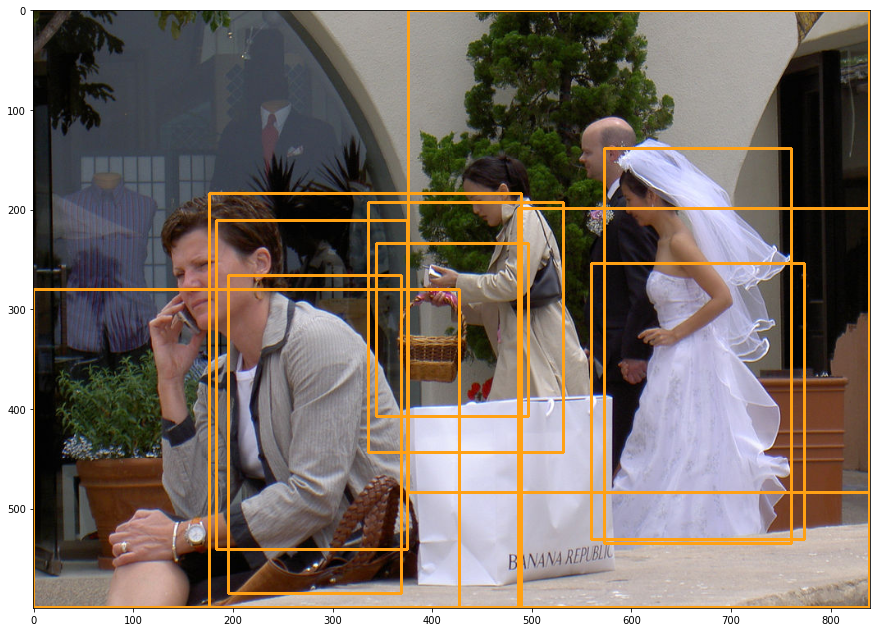

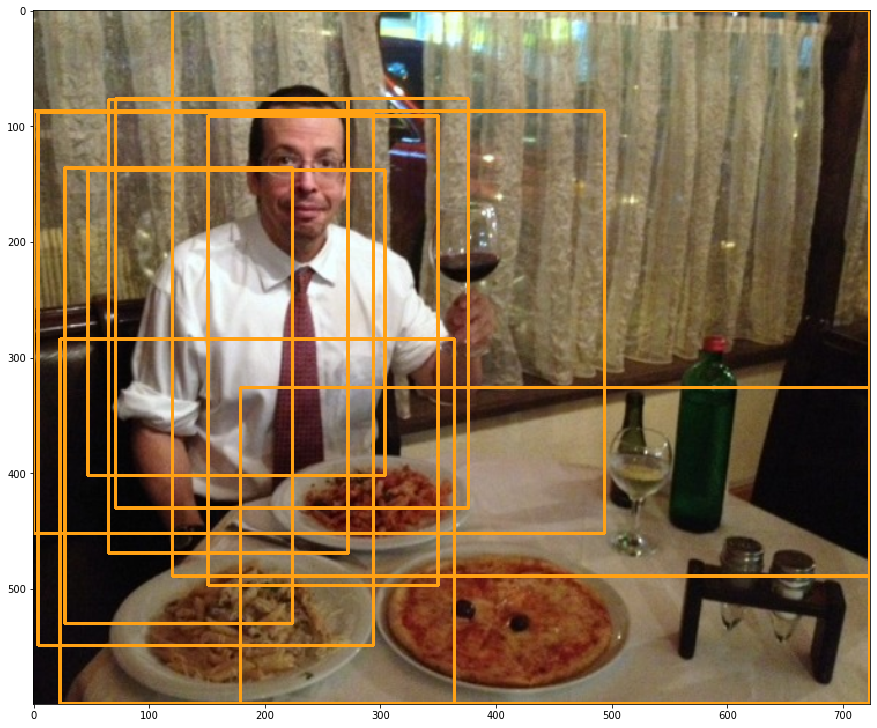

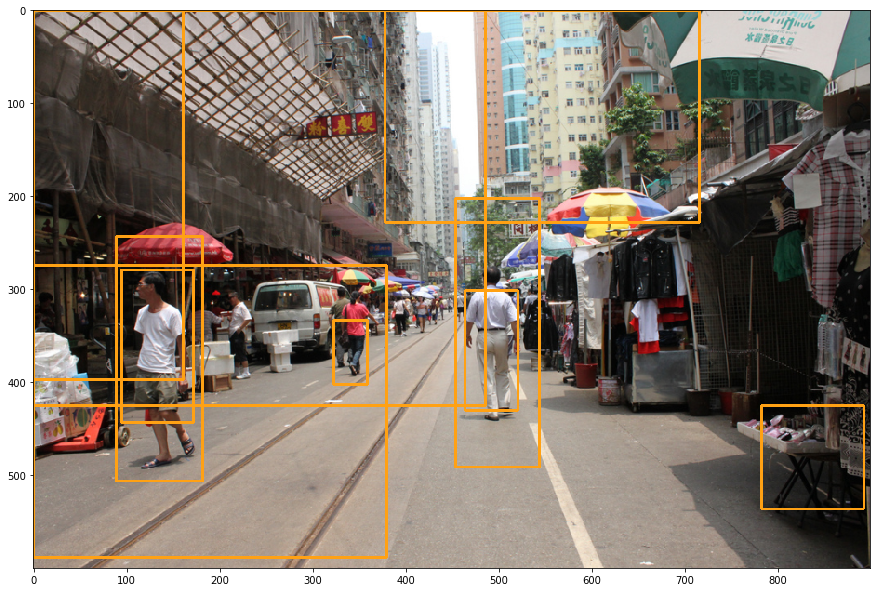

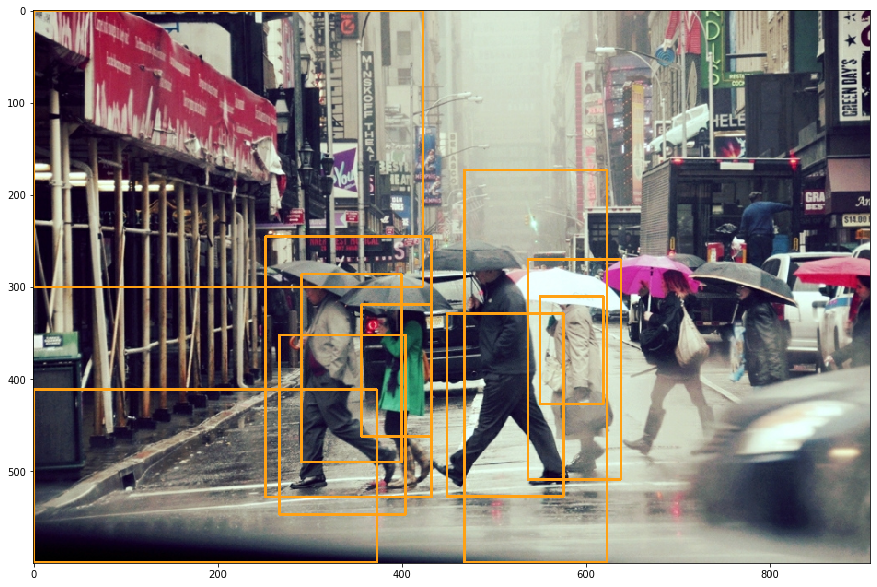

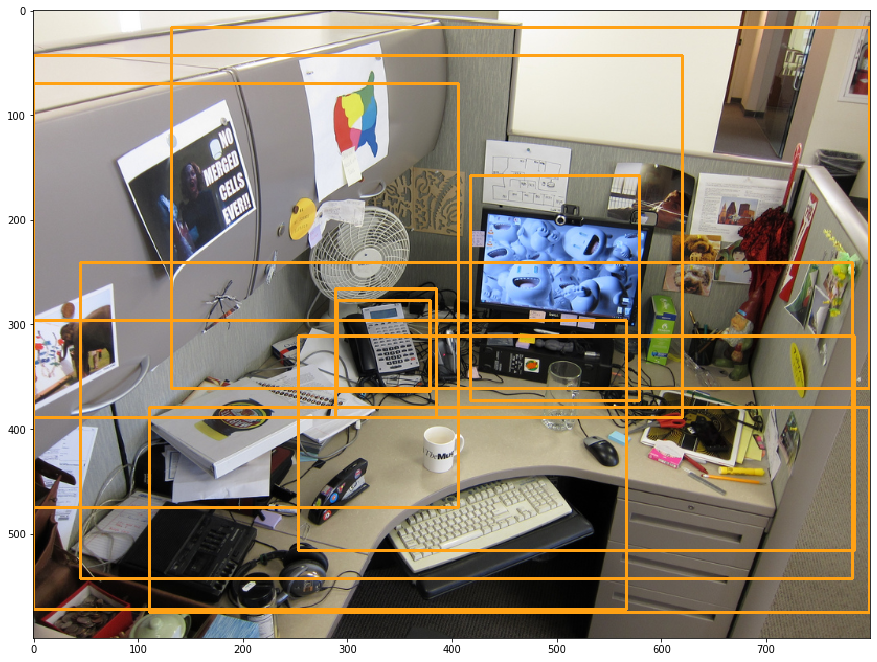

...

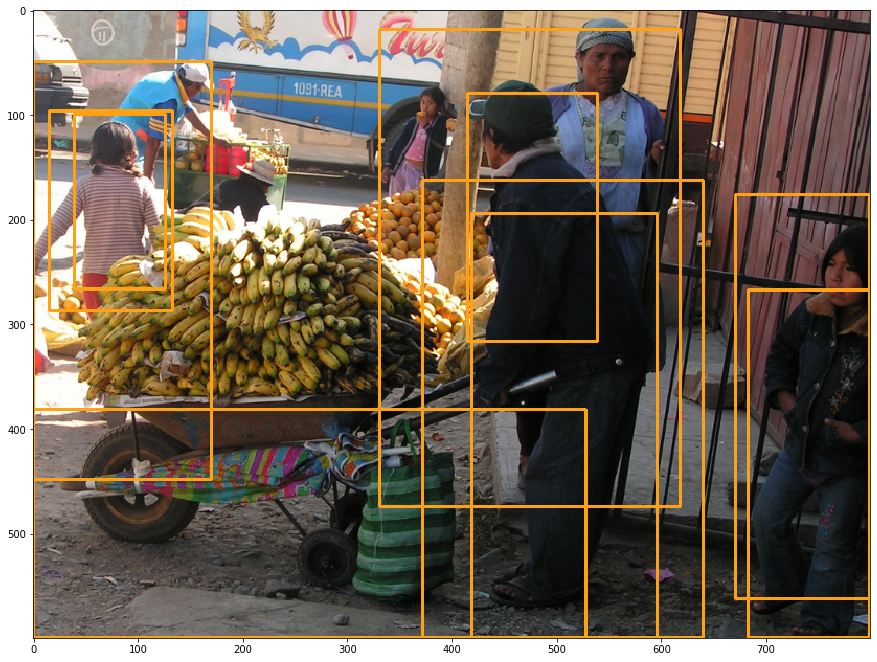

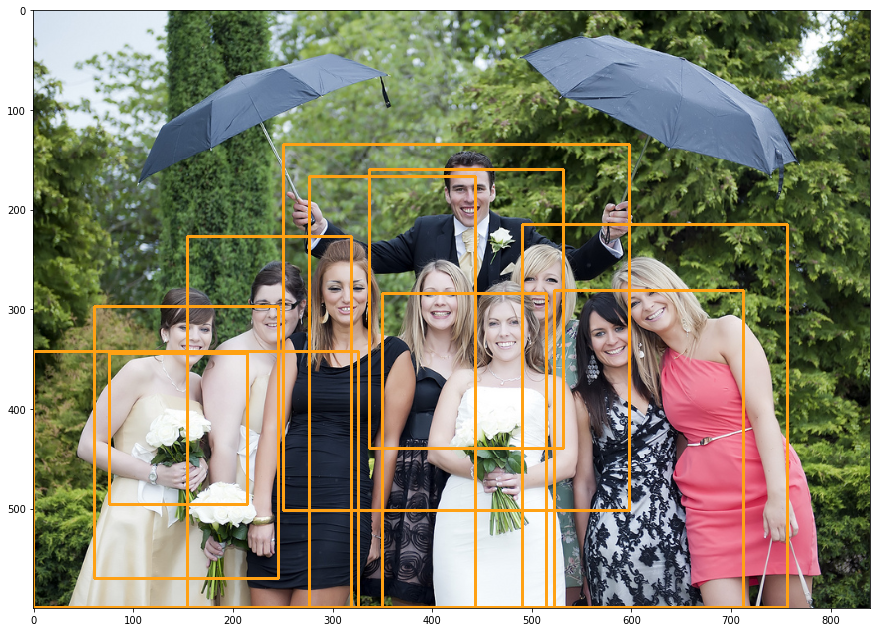

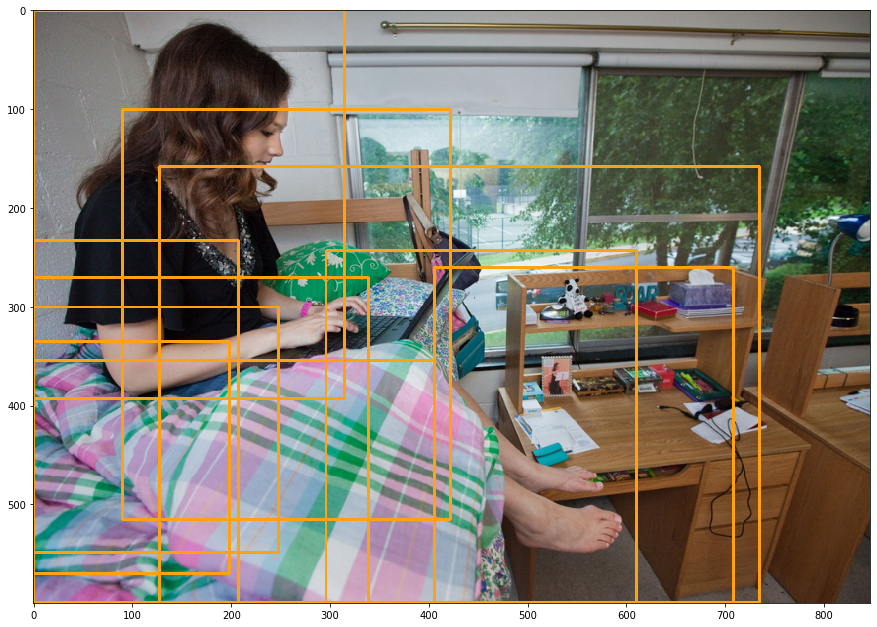

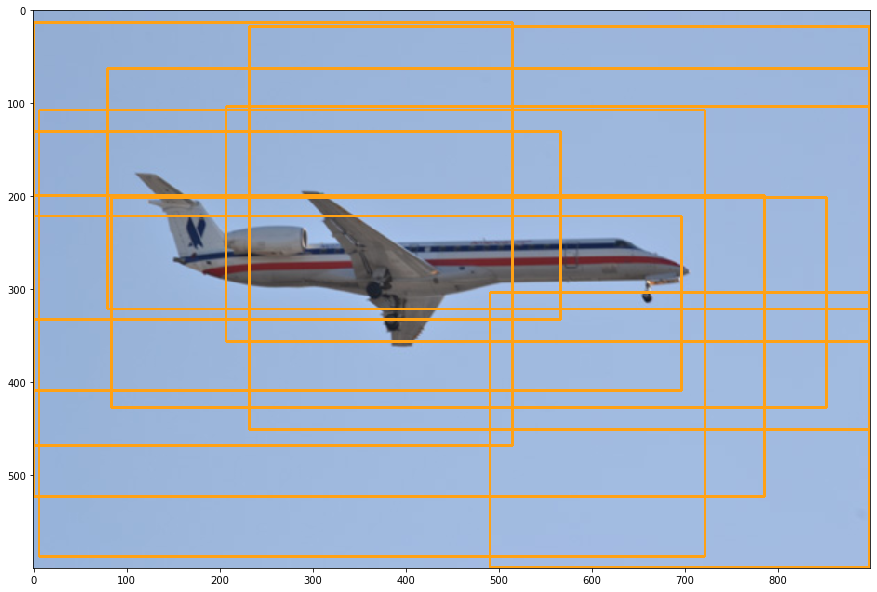

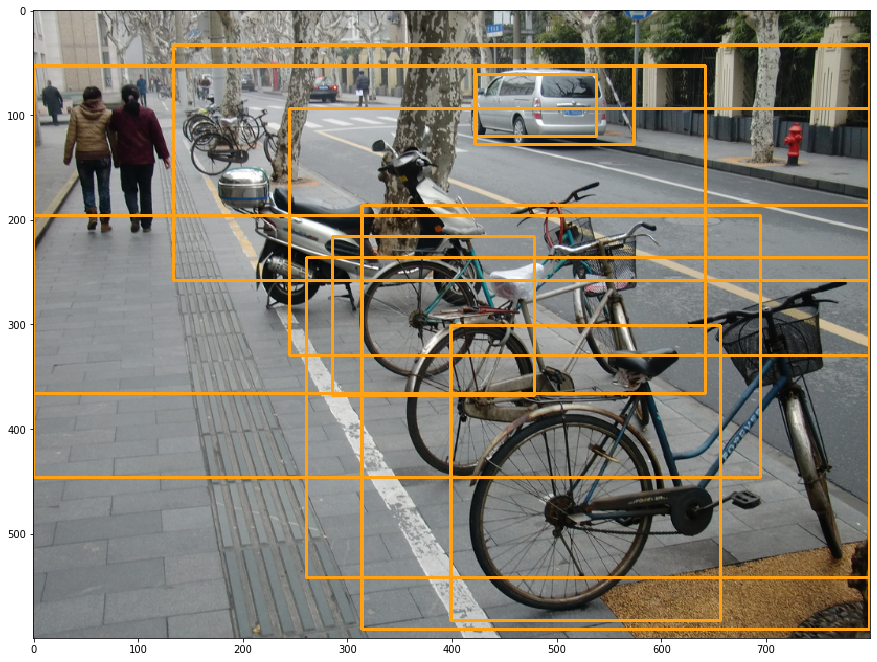

In [6]:
for i, file in enumerate(testImages):
    jsonRaw = json.load(open("../gossipnet-pytorch/output-0.7-0.5-350-0.3-4-full/test_vrd/" + file + ".json"))
    
    gtboxes = jsonRaw['detections'][10:20]
    img_scale = jsonRaw['scale']
    
    plotDetNMS(str(i+1), file, gtboxes, img_scale, 'test')

# plotting rescored detections - 350

In [8]:
def plotRDET(i, file, dets, img_scale, mode, filename, color):
    img = cv2.imread("../FactorizableNet/data/images/vrd/sg_" + mode + "_images/" + file + ".jpg")
    img = cv2.resize(img, None, None, fx
                     =img_scale, fy=img_scale, interpolation=cv2.INTER_LINEAR)

    # draw detections
    for box in dets:
        x1 = int(box[0])
        y1 = int(box[1])
        x2 = int(box[2])
        y2 = int(box[3])
        
        img = cv2.rectangle(img, (x1, y1), (x2, y2), color, 2)
        
#     cv2.imwrite("./gossipnet-visual/ex" + i + "/" + filename + ".jpg", img)
# 
    fig = plt.figure(figsize=(15, 15))
    ax = fig.add_subplot(111)
    ax.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB), aspect='equal')  

#     cv2.imshow("img", img)
#     cv2.waitKey(0)
#     cv2.destroyAllWindows()

In [13]:
for i, file in enumerate(testImages):
    jsonRaw = json.load(open("../gossipnet-pytorch/output-0.7-0.5-350-0.3-4-full/test_vrd/" + file + ".json"))
    
    dets = np.array(jsonRaw['detections'][:350])
    new_scores = softmax(np.array(jsonRaw['predictions'])) 
    scores_dec_order_index = np.argsort(-new_scores)
    
    dets10 = dets[scores_dec_order_index[:10]]
    dets10 = dets10.tolist()
    
    print (new_scores[scores_dec_order_index[:10]])
    print (new_scores[scores_dec_order_index][:10])
    print (scores_dec_order_index)
    
    break
#     img_scale = jsonRaw['scale']
    
    
#     plotRDET(str(i+1), file, dets10, img_scale, 'test', 'dets350', (0, 0, 255))
    
#     # next 10
#     dets102 = dets[scores_dec_order_index[10:20]]
#     dets102 = dets102.tolist()
    
#     plotRDET(str(i+1), file, dets102, img_scale, 'test', 'dets350_2', (0, 0, 255))

[0.50678235 0.26477031 0.03002918 0.02080294 0.02028574 0.01132686
 0.00930266 0.00883387 0.00877563 0.00845889]
[0.50678235 0.26477031 0.03002918 0.02080294 0.02028574 0.01132686
 0.00930266 0.00883387 0.00877563 0.00845889]
[  3   4  26  65   5  27  36 118   7  11  62  54  22  70  77  80  25 309
   2 114 157 158  12 194  41 109  71  23  28 227 222  30  34  37  21  75
 168 160 115  94  46  31  73   8 164 330 124 178  83 273 319  51   6  40
 111 257 112  47  82  14 347 307  13 306  24   0  35  86 208 241 204  44
 223 304  95 226 201 144 163 322  10 210 108  18  19 170 119 311 143 126
 289 268 282 219 215 123  96 171  79 239 101 275  85  92  81 177 150 185
  57  74  38 305  63 183  33  45 240 128 313 139 294  84 340 104   9 198
 272  58 255 205 228 256 230 173  93 317 193 131 325 142 189 206 191 180
 249 125  97 129 213 293 235 120 175  66 237  42 321 329 190  20 152  76
 234 133 192 105  50 277 196  16  69 308 278 341 290 137 138  56 345   1
 225 161 328 186 154  78  68 207 332 264 141

# plotting rescored detections - 2000(50) - top 10

In [22]:
for i, file in enumerate(testImages):
    jsonRaw = json.load(open("../gossipnet-pytorch/output-0.8-2000(50)-0.3-4-full/test_vrd/" + file + ".json"))
    
    dets = np.array(jsonRaw['detections'][:2000])
    new_scores = softmax(np.array(jsonRaw['predictions'])) 
    scores_dec_order_index = np.argsort(-new_scores)
    
    dets = dets[scores_dec_order_index[:10]]
    dets = dets.tolist()
    
    img_scale = jsonRaw['scale']
    
    plotRDET(str(i+1), file, dets, img_scale, 'test', 'dets2000', (255, 20, 220))

# plotting rescored detections - cc - 400

In [28]:
for i, file in enumerate(testImages):
    jsonRaw = json.load(open("../gossipnet-pytorch/output-0.8-2000(cc)-0.2-4-full/test_vrd/" + file + ".json"))
    scale = json.load(open("../gossipnet-pytorch/output-0.8-2000(50)-0.3-4-full/test_vrd/" + file + ".json"))['scale']
    
    dets = np.array(jsonRaw['detections'][:400])
    new_scores = softmax(np.array(jsonRaw['predictions'])) 
    scores_dec_order_index = np.argsort(-new_scores)
    
    dets10 = dets[scores_dec_order_index[:10]]
    dets10 = dets10.tolist()
    
    plotRDET(str(i+1), file, dets10, scale, 'test', 'cc400', (40, 227, 231))
    
    dets20 = dets[scores_dec_order_index[10:20]]
    dets20 = dets20.tolist()
    
    plotRDET(str(i+1), file, dets20, scale, 'test', 'cc400_2', (40, 227, 231))

# plotting rescored detections - cn - 2000(50, 50)

In [24]:
for i, file in enumerate(testImages):
    jsonRaw = json.load(open("../gossipnet-pytorch/output-0.8-2000(cn)-0.3-4-full/test_vrd/" + file + ".json"))
    scale = json.load(open("../gossipnet-pytorch/output-0.8-2000(50)-0.3-4-full/test_vrd/" + file + ".json"))['scale']
    
    dets = np.array(jsonRaw['detections'][:2000])
    new_scores = softmax(np.array(jsonRaw['predictions'])) 
    scores_dec_order_index = np.argsort(-new_scores)
    
    dets = dets[scores_dec_order_index[:10]]
    dets = dets.tolist()
    
    plotRDET(str(i+1), file, dets, scale, 'test', 'cn2000', (231, 140, 40))

drawing quadrant boxes

In [31]:
def visualizeQuads(index, file, dets, selected_dets, target_scale, mode):
    img = cv2.imread("../FactorizableNet/data/images/vrd/sg_" + mode + "_images/" + file + ".jpg")

    img_scale = target_scale
    img = cv2.resize(img, None, None, fx=img_scale, fy=img_scale, interpolation=cv2.INTER_LINEAR)

    height = img.shape[0]
    width = img.shape[1]
    
    starth = height/6
    startw = width/6
    
    quadw = width/3
    quadh = height/3
    
    for i in range(3):
        for j in range(3):
            new_img = img.copy()
            
            x = int(startw + i*quadw)
            y = int(starth + j*quadh)
            
            # quadrant limits
            xllim = x - quadw/2
            xulim = x + quadw/2
                
            yllim = y - quadh/2
            yulim = y + quadh/2
            
            # draw the quadrant box
            new_img = cv2.rectangle(new_img, (int(xllim), int(yllim)), (int(xulim), int(yulim)), (255, 255, 255), 5)

            for det in dets:
                x_center = int((det[0] + det[2])/2)
                y_center = int((det[1] + det[3])/2)
                
                if (x_center < xllim or y_center < yllim):
                    continue
                elif (x_center > xulim or y_center > yulim):
                    continue
                
                new_img = cv2.rectangle(new_img, (int(det[0]), int(det[1])), (int(det[2]), int(det[3])), (255, 0, 0), 1)
                
            for det in selected_dets:
                x_center = int((det[0] + det[2])/2)
                y_center = int((det[1] + det[3])/2)
                
                if (x_center < xllim or y_center < yllim):
                    continue
                elif (x_center > xulim or y_center > yulim):
                    continue
                
                new_img = cv2.rectangle(new_img, (int(det[0]), int(det[1])), (int(det[2]), int(det[3])), (0, 0, 255), 3)
                
                
            # add a border to the image
            new_img = cv2.copyMakeBorder(new_img, 10, 10, 10, 10, cv2.BORDER_CONSTANT)
    
#             cv2.imshow("img", new_img)
#             cv2.waitKey(0)
#             cv2.destroyAllWindows()

            cv2.imwrite("./gossipnet-visual/" + mode + "/ex" + index + "/" + str(i) + "_" + str(j) + ".jpg", new_img)

In [32]:
for i, file in enumerate(trainImages):
    jsonRaw = json.load(open("./output/train_vrd/" + file + ".json"))
    
    dets = np.array(jsonRaw['detections'][:350])
    
    new_scores = softmax(np.array(jsonRaw['predictions'])) 
    scores_dec_order_index = np.argsort(-new_scores)
    selected_dets = dets[scores_dec_order_index[:10]]
    
    dets = dets.tolist()
    selected_dets = selected_dets.tolist()
    
    print ("image: {}".format(file))
    print ("no gt: {}".format(len(jsonRaw['gt_boxes'])))
    print ("no dets: {}".format(len(dets)))
    
    img_scale = jsonRaw['scale']
    
    visualizeQuads(str(i+1), file, dets, selected_dets, img_scale, 'train')

image: 20099217_861b5a76e5_b
no gt: 7
no dets: 350
image: 25691390_f9944f61b5_b
no gt: 10
no dets: 238
image: 86530608_2c931bb40b_b
no gt: 12
no dets: 350
image: 6212161594_1e1c2d022a_b
no gt: 5
no dets: 350
image: 6187182607_8d1eba6cf6_b
no gt: 5
no dets: 350


In [33]:
for i, file in enumerate(testImages):
    jsonRaw = json.load(open("./output/test_vrd/" + file + ".json"))
    
    dets = np.array(jsonRaw['detections'][:350])
    
    new_scores = softmax(np.array(jsonRaw['predictions'])) 
    scores_dec_order_index = np.argsort(-new_scores)
    selected_dets = dets[scores_dec_order_index[:10]]
    
    dets = dets.tolist()
    selected_dets = selected_dets.tolist()
    
    print ("image: {}".format(file))
    print ("no gt: {}".format(len(jsonRaw['gt_boxes'])))
    print ("no dets: {}".format(len(dets)))
    
    img_scale = jsonRaw['scale']
    
    visualizeQuads(str(i+1), file, dets, selected_dets, img_scale, 'test')

image: 19014116_fbde61c01e_b
no gt: 11
no dets: 350
image: 7987560060_c4e5b82ae2_o
no gt: 9
no dets: 350
image: 7764246408_05d3df45b1_b
no gt: 11
no dets: 350
image: 5663152990_60111361e0_b
no gt: 16
no dets: 350
image: 5217423633_9c2269df63_b
no gt: 6
no dets: 350


In [99]:
jsonData2 = json.load(open("./output/test_vrd/19014116_fbde61c01e_b.json"))

In [100]:
jsonData2['predictions']

[-4.902016639709473,
 -7.765392303466797,
 -3.1354317665100098,
 2.0749096870422363,
 1.425690770149231,
 -1.1432538032531738,
 -4.5749616622924805,
 -1.9811928272247314,
 -4.258293628692627,
 -6.681586265563965,
 -5.330333232879639,
 -2.017953872680664,
 -3.4481143951416016,
 -4.786294460296631,
 -4.748588562011719,
 -8.996932983398438,
 -7.599876880645752,
 -8.74390697479248,
 -5.408968925476074,
 -5.414615631103516,
 -7.413942337036133,
 -3.8917131423950195,
 -2.618201732635498,
 -3.7212393283843994,
 -4.852563858032227,
 -2.803781509399414,
 -0.7510022521018982,
 -1.7259950637817383,
 -3.731297254562378,
 -8.136857032775879,
 -3.791186809539795,
 -4.196614742279053,
 -8.566689491271973,
 -6.476532936096191,
 -3.8246090412139893,
 -4.9692277908325195,
 -1.922871470451355,
 -3.82731556892395,
 -6.311882972717285,
 -10.551011085510254,
 -4.593234062194824,
 -3.5340538024902344,
 -7.310153484344482,
 -8.066356658935547,
 -5.109362602233887,
 -6.490126132965088,
 -4.168302059173584,
 -4

In [58]:
jsonData = json.load(open("./test_result.json"))

FileNotFoundError: [Errno 2] No such file or directory: './test_result.json'

In [59]:
jsonData.keys()

dict_keys(['scale', 'file_name', 'predictions', 'detections', 'gt_boxes', 'scores'])

In [64]:
len(jsonData['detections'][:350])

350

In [94]:
jsonData['file_name']

'19014116_fbde61c01e_b.json'

In [95]:
len(jsonData['predictions'])

350

In [96]:
new_scores = jsonData['predictions']

In [97]:
new_scores

[-7.061354637145996,
 -4.878665924072266,
 0.3664308786392212,
 4.964405059814453,
 5.510326385498047,
 -5.345272064208984,
 -4.805596828460693,
 -1.8507254123687744,
 -8.101358413696289,
 -9.88670539855957,
 -0.1242837905883789,
 -3.8505771160125732,
 -3.760653257369995,
 -6.790578365325928,
 -9.703450202941895,
 -9.955609321594238,
 -9.974157333374023,
 -2.580718517303467,
 -4.580283164978027,
 -5.230842590332031,
 -3.510071277618408,
 -6.150820732116699,
 -3.591597318649292,
 -4.156023025512695,
 -5.08546257019043,
 2.372007369995117,
 -0.9371599555015564,
 -3.6039090156555176,
 -4.296243667602539,
 -19.38461685180664,
 -3.924285411834717,
 -5.068236827850342,
 -18.757587432861328,
 -12.740091323852539,
 -3.669829845428467,
 -7.25353479385376,
 -2.006492853164673,
 -3.9510934352874756,
 -8.249129295349121,
 -8.190740585327148,
 0.36755186319351196,
 -9.495716094970703,
 -4.467931270599365,
 -10.064337730407715,
 -12.278823852539062,
 -14.5042724609375,
 -3.1249630451202393,
 -2.3370

In [66]:
dets = jsonData['detections'][:350]

In [68]:
cond = np.array(new_scores) > 0

In [83]:
new_scores

array([False, False, False, False,  True, False, False,  True,  True,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False,  True,  True,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False,

In [82]:
cond

array([False, False,  True,  True,  True, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False,  True, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False,  True, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
        True, False, False, False, False, False, False, False,  True,
       False, False,  True, False, False, False, False,  True, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False,

In [75]:
np.sum(cond)

9

In [76]:
np.asarray(dets)[cond].tolist()

[[0.0, 279.86020739504016, 280.76710062595953, 599.0],
 [39.58984691031861, 164.6715276062406, 350.80891719875484, 599.0],
 [462.6392008382474, 23.12666600207504, 788.3849665572841, 489.9060115231829],
 [119.28390070503045, 219.59417019785087, 389.46338794517544, 599.0],
 [208.34425728979988, 29.66324186546791, 788.3518380607267, 535.8717576778324],
 [544.2731666300228, 88.93507874422178, 767.4831031768306, 383.87542274350017],
 [103.07814842617222, 4.170095086033172, 839.0, 289.27074625030184],
 [369.106033497275, 292.587317198326, 439.73191811900176, 365.2797622116484],
 [0.0, 16.685489452597693, 699.1853851805301, 301.4127905981177]]

In [71]:
dets[cond.tolist()]

TypeError: list indices must be integers or slices, not list

In [4]:
file_name = jsonData['file_name']
file_name

'19014116_fbde61c01e_b.json'

In [5]:
len(jsonData['detections'])

1002

In [6]:
dets = jsonData['detections'][:350]

In [7]:
gt = jsonData['gt_boxes']

In [8]:
len(gt)

11

In [9]:
new_scores = jsonData['predictions']

In [10]:
index = []
count = 0
for i, val in enumerate(new_scores):
    if val > 0:
        index.append(i)
        count += 1
print (count)

9


In [11]:
# drawing boxes and getting an idea

In [12]:
json = json.load(open("./data/vrd/test/" + file_name))

In [13]:
len(json['gt_boxes'])

11

In [44]:
file_name

'19014116_fbde61c01e_b.json'

In [39]:
img = cv2.imread("../FactorizableNet/data/images/vrd/sg_test_images/" + file_name.split(".")[0] + ".jpg")
img_scale = json['scale']
img = cv2.resize(img, None, None, fx=img_scale, fy=img_scale, interpolation=cv2.INTER_LINEAR)

In [40]:
img = cv2.cvtColor(img, cv2.COLOR_BGR2BGRA)
img = cv2.rectangle(img, (x1, y1), (x2, y2), (0, 0, 255, 0.1), 2)

In [41]:
cv2.imshow('img', img)
cv2.waitKey(0)
cv2.destroyAllWindows()

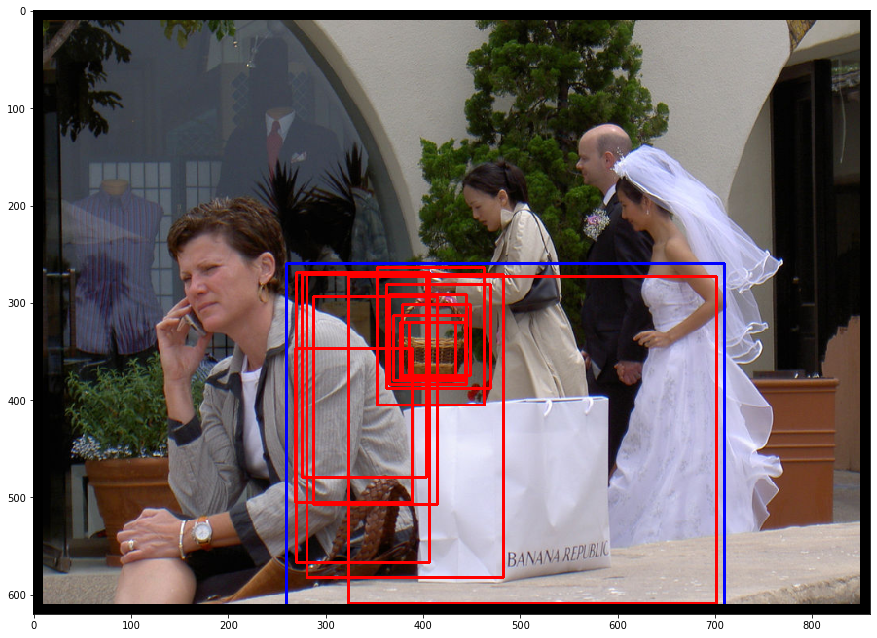

In [24]:
# plotting detection's - 350
new_img = img.copy()
for i, box in enumerate(dets):
    x1 = int(box[0])
    y1 = int(box[1])
    x2 = int(box[2])
    y2 = int(box[3])
    upperLeft = (250, 250)
    lowerRight = (700, 700)
    
    new_img = cv2.rectangle(new_img, upperLeft, lowerRight, (255, 0, 0), 2)
    
    if (x1 > upperLeft[0] and y1 > upperLeft[1]):
        if (x2 < lowerRight[0] and y2 < lowerRight[1]):
            new_img = cv2.rectangle(new_img, (x1, y1), (x2, y2), (0, 0, 255, 0.9), 2)
            
            if i in index:
                new_img = cv2.rectangle(new_img, (x1, y1), (x2, y2), (0, 0, 255), 2)

new_img = cv2.copyMakeBorder(new_img, 10, 10, 10, 10, cv2.BORDER_CONSTANT)

fig = plt.figure(figsize=(15, 15))
ax = fig.add_subplot(111)
    
ax.imshow(cv2.cvtColor(new_img, cv2.COLOR_BGR2RGB), aspect='equal')

# cv2.imshow('img', new_img)
# cv2.waitKey(0)
# cv2.destroyAllWindows()

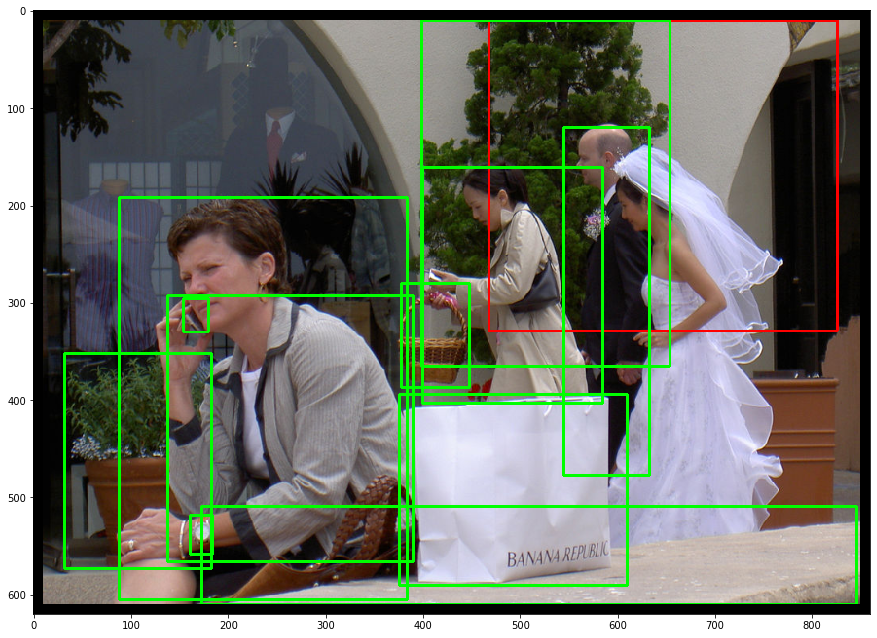

In [43]:
# plotting gt
new_img = img.copy()
for box in gt:
    new_img = cv2.rectangle(new_img, (int(box[0]), int(box[1])), (int(box[2]), int(box[3])), (0, 255, 0), 2)

new_img = cv2.copyMakeBorder(new_img, 10, 10, 10, 10, cv2.BORDER_CONSTANT)

fig = plt.figure(figsize=(15, 15))
ax = fig.add_subplot(111)
    
ax.imshow(cv2.cvtColor(new_img, cv2.COLOR_BGR2RGB), aspect='equal')
    
# cv2.imshow('img', new_img)
# cv2.waitKey(0)
# cv2.destroyAllWindows()

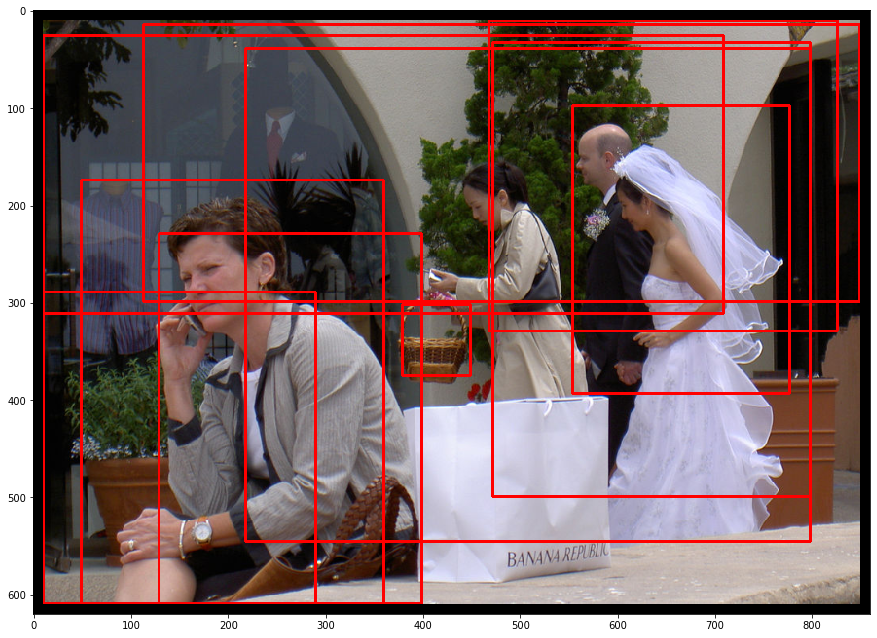

In [42]:
new_img = img.copy()
for i, box in enumerate(dets):
    if i in index:
        new_img = cv2.rectangle(new_img, (int(box[0]), int(box[1])), (int(box[2]), int(box[3])), (0, 0, 255), 2)

new_img = cv2.copyMakeBorder(new_img, 10, 10, 10, 10, cv2.BORDER_CONSTANT)
  
fig = plt.figure(figsize=(15, 15))
ax = fig.add_subplot(111)
    
ax.imshow(cv2.cvtColor(new_img, cv2.COLOR_BGR2RGB), aspect='equal')    
    
# cv2.imshow('img', new_img)
# cv2.waitKey(0)
# cv2.destroyAllWindows()